In [ ]:
# installing required libraries
! pip install networkx
! pip install plotly
! pip install colorlover
! pip install NRCLex
! pip install tweet-preprocessor

In [ ]:
#importing required functions

import pandas as pd
import numpy as np
from collections import Counter
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.graph_objects as go
init_notebook_mode(connected=True)

import colorlover as cl
from IPython.display import HTML
import preprocessor as p

import re
import nltk
from nrclex import NRCLex
nltk.download('punkt')
from nltk.stem import *
nltk.download("stopwords")
from nltk.corpus import stopwords

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
# configuring plotly browser state to represent networkgraph
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML(
      '''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))


In [ ]:
# defining dataframe from csv file
df = pd.read_csv("corona_tweets.csv")

In [ ]:
print("Num of rows:", df.shape[0])

Num of rows: 2550194


In [ ]:
df.head()

,date,user,tweet
0,2020-11-01T04:25:52.000Z,bernadettecomm1,RT @ClarkeMicah: Anti-lockdown Letters to MPs ...
1,2020-11-01T04:25:52.000Z,bluemeade7,RT @petestrzok: RT is registered with the Depa...
2,2020-11-01T04:25:52.000Z,_raauull,RT @essmeraldasauce: COVID cases broke single-...
3,2020-11-01T04:25:53.000Z,purushothama_n,"RT @SadhguruJV: By their very design, most cit..."
4,2020-11-01T04:25:53.000Z,fato_frank,RT @RealCandaceO: Germany and France go back i...


In [ ]:
# Converting Date to required format
df['date']=pd.to_datetime(df['date'].str.slice(0,-5),format='%Y-%m-%dT%H:%M:%S')

In [ ]:
df.head()

,date,user,tweet
0,2020-11-01 04:25:52,bernadettecomm1,RT @ClarkeMicah: Anti-lockdown Letters to MPs ...
1,2020-11-01 04:25:52,bluemeade7,RT @petestrzok: RT is registered with the Depa...
2,2020-11-01 04:25:52,_raauull,RT @essmeraldasauce: COVID cases broke single-...
3,2020-11-01 04:25:53,purushothama_n,"RT @SadhguruJV: By their very design, most cit..."
4,2020-11-01 04:25:53,fato_frank,RT @RealCandaceO: Germany and France go back i...


In [ ]:
# preprocessing tweets
allTweets = df["tweet"].str.cat(sep=' ')
tweetWords = [word.strip(""" ,.:'\";""").lower() for word in allTweets.split()]
hashTags = [word for word in tweetWords if word.startswith("#")]
hashTagsCounter = Counter(hashTags) #counting hashtags

In [ ]:
# checking the most common hashtags
hashTagsCounter.most_common(150)

[('#1', 87335),
 ('#covid19', 75713),
 ('#coronavirus', 21472),
 ('#covid', 13419),
 ('#lockdown', 11150),
 ('#covid_19', 8178),
 ('#covidiots', 6838),
 ('#lockdown2', 6576),
 ('#vote', 6328),
 ('#wewillnotcomply', 6109),
 ('#pandemic', 5692),
 ('#trump', 4568),
 ('#closetheschools', 3860),
 ('#wearamask', 3587),
 ('#marr', 3005),
 ('#breaking', 2942),
 ('#panicbuying', 2796),
 ('#closeschoolsnow', 2678),
 ('#…', 2587),
 ('#excludeduk', 2540),
 ('#nasaanangpangulo', 2532),
 ('#nhs', 2420),
 ('#art', 2340),
 ('#lockdownuk', 2282),
 ('#staysafe', 2199),
 ('#covid19uk', 2110),
 ('#halloween2020', 2096),
 ('#stayhome', 1888),
 ('#votehimout', 1884),
 ('#corona', 1859),
 ('#covid-19', 1824),
 ('#biden', 1811),
 ('#bidenharris2020', 1807),
 ('#wfh', 1786),
 ('#votebluetoendthenightmare', 1767),
 ('#halloween', 1717),
 ('#2ndlockdown', 1656),
 ('#florida', 1564),
 ('#election2020', 1478),
 ('#trumpdeliverednothing', 1408),
 ('#taiwanmodel', 1381),
 ('#trumpvirus', 1372),
 ('#', 1365),
 ('#wor

## Q1. Mention graph: Selecting #covidiots tag to build the mention graph

In [ ]:
# to make a new dataframe just with our hashtag
covidoitsTag = df[df["tweet"].str.lower().str.contains("#covidiots", na=False, regex=False)].copy()
covidoitsTag

,date,user,tweet
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...
5091,2020-11-01 04:30:07,drcsyntax,Watching the original Dawn of The Dead tonight...
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...
6734,2020-11-01 04:31:25,gwarkowianka,#Covid19 #covidiots read on... https://t.co/SM...
...,...,...,...
2545160,2020-11-02 04:21:33,goosejazz,"RT @dvillella: @realDonaldTrump ""You knew I wa..."
2546209,2020-11-02 04:22:17,415_707_49_24_7,@JRehling @mmpadellan Trees that grow cars? Ma...
2547396,2020-11-02 04:23:10,annieggb,"@realDonaldTrump Another Covid party, you’re a..."
2547437,2020-11-02 04:23:12,tennie33,Disgusting #COVIDIOTS https://t.co/yLfC1zv39z


In [ ]:
# checking the tweets with the tag
covidoitsTag['tweet'].reset_index().drop('index',axis=1)['tweet'][76]

'RT @AtoKwamina_: This thing ain’t gone oooo... Wear your mask please!\n#COVIDIOTS #COVID19 https://t.co/KBoW5AgAGe'

In [ ]:
# function to extract the people/tags mentioned in the tweet
def addMentionedColumn(df):  
    def mentionsList(txt):
        allWords = [word.strip(""" ,.:'\";""").lower() for word in txt.split()]
        allNames = [word.strip("@") for word in allWords if word.startswith("@")]
        uniqueNames = list(set(allNames))
        return allNames
    
    df["mentioned"] = df["tweet"].apply(mentionsList)

In [ ]:
# Using the function on the covidiots Tag
addMentionedColumn(covidoitsTag)

In [ ]:
covidoitsTag.head()

,date,user,tweet,mentioned
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...,[]
5091,2020-11-01 04:30:07,drcsyntax,Watching the original Dawn of The Dead tonight...,[]
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...,[teamtrump]
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...,"[busydrt, borisjohnson]"
6734,2020-11-01 04:31:25,gwarkowianka,#Covid19 #covidiots read on... https://t.co/SM...,[]


In [ ]:
# Mention graph for the tweets
def mentionGraph(df):
    g = nx.Graph()
    for (index, date,user, tweet, mentionedUsers) in df.itertuples():
        for mentionedUser in mentionedUsers:
            if mentionedUser in df['user']:
              print(mentionedUser)
            if (user in g) and (mentionedUser in g[user]):
                g[user][mentionedUser]["numberMentions"] += 1
            else:
                g.add_edge(user, mentionedUser, numberMentions=1)  
    return g

In [ ]:
# Mention graph using covidiots tag
covidiotsGraph = mentionGraph(covidoitsTag)

### a) Nodes and edges in the Tag

In [ ]:
# checking the number of nodes and edges in the covidiot tweets
print("Number of Nodes:", len(covidiotsGraph.nodes()))
print("Number of Edges:", len(covidiotsGraph.edges()))

Number of Nodes: 6179
Number of Edges: 6284


In [ ]:
# checking the nodes
print(covidiotsGraph.nodes)

['odysseyrabbit', 'teamtrump', 'fahadaz63501106', 'busydrt', 'borisjohnson', 'wittatwitta', 'david13353252', 'darrylbain1967', 'petercredlin_pw', 'danielandrewsmp', 'greenpeaches2', 'axios', 'roxdog2012', 'kayleighmcenany', 'realdonaldtrump', 'aleeah26765972', 'conlibe', 'nbcnews', 'tspin18', 'kittykatbalou', 'cnnpolitics', 'kate_eviva', 'hazrobert', 'xoahubeachx', 'caroljhedges', 'beauty_damned', 'manairport', 'jenxpaige', 'mysterysolvent', 'blacksherrybl', 'king_of_shade', 'zsoka127', 'realrlimbaugh', 'asksasidhar', 'dhanyarajendran', 'cmotamilnadu', 'boomsbusts', 'box_a_chocluts', 'suitandtiegirl', 'rrosenthalnyc', 'kathygriffin', 'duasahildua1', 'gulf_news', 'jeff05239890', 'juliahb1', 'chriswhite04', 'facebook', 'beverlyfolkers', 'oxforduk23', 'deejay90192', 'djjudd', 'breitbartnews', 'crittersofaveb', 'trumpwarroom', 'katie_hornor', 'westofscenic', 'slnewsrtbot', 'lasaa_v', 'oratorjames', 'johnkamau1', 'sfgamerbabe57', 'thesaucyliberal', 'ryanvoutilainen', 'adriandix', 'kjosephk7

In [ ]:
# Checking the edges
print(covidiotsGraph.edges)

[('odysseyrabbit', 'teamtrump'), ('odysseyrabbit', 'zenazenawarrior'), ('odysseyrabbit', 'osira'), ('odysseyrabbit', 'tiffanyatrump'), ('odysseyrabbit', 'realdonaldtrump'), ('teamtrump', 'zenazenawarrior'), ('teamtrump', 'osira'), ('teamtrump', 'rob29899'), ('teamtrump', 'distorterin'), ('teamtrump', 'changingwindsmo'), ('fahadaz63501106', 'busydrt'), ('fahadaz63501106', 'borisjohnson'), ('busydrt', 'aleeah26765972'), ('busydrt', 'tspin18'), ('busydrt', 'boomsbusts'), ('busydrt', 'hibernian1962'), ('busydrt', 'mrgfreedom1'), ('busydrt', 'kenasmith49'), ('busydrt', 'watcotorg'), ('busydrt', 'muavizqamar'), ('busydrt', 'taytamarian'), ('busydrt', 'karenskurka'), ('busydrt', 'trigger3215'), ('busydrt', 'trikkeman'), ('busydrt', 'pmcmetalrambler'), ('busydrt', 'scpclement'), ('busydrt', 'pmargot'), ('busydrt', 'mickd18314120'), ('busydrt', 'ianmacleod14'), ('busydrt', 'yourdollshome'), ('busydrt', 'brimmy1967'), ('busydrt', 'conciousness777'), ('busydrt', 'coryransom2'), ('busydrt', 'samph

In [ ]:
# checking the number of mentions from the node teamtrump
covidiotsGraph['teamtrump']

AtlasView({'odysseyrabbit': {'numberMentions': 1}, 'zenazenawarrior': {'numberMentions': 1}, 'osira': {'numberMentions': 1}, 'rob29899': {'numberMentions': 2}, 'distorterin': {'numberMentions': 1}, 'changingwindsmo': {'numberMentions': 1}})

In [ ]:
# mention graph
nx.draw(covidiotsGraph, with_labels=False)

### b) Histogram of graph nodes' degree

In [ ]:
# Checking the degree values
dict_cidg = dict(covidiotsGraph.degree)
dict_cidg.values()

In [ ]:
# Counting each degree value
Counter(list(dict_cidg.values()))

Counter({1: 4797,
         2: 712,
         3: 254,
         4: 140,
         5: 82,
         6: 31,
         7: 35,
         8: 26,
         9: 11,
         10: 11,
         11: 7,
         12: 5,
         13: 7,
         14: 5,
         15: 5,
         16: 5,
         17: 3,
         18: 1,
         19: 3,
         20: 3,
         21: 2,
         22: 1,
         23: 1,
         24: 2,
         25: 3,
         26: 2,
         28: 1,
         30: 2,
         31: 2,
         33: 1,
         36: 1,
         37: 2,
         38: 1,
         39: 1,
         47: 1,
         50: 1,
         55: 1,
         60: 1,
         64: 1,
         79: 1,
         83: 1,
         88: 2,
         119: 1,
         157: 1,
         178: 1,
         212: 1,
         1216: 1})

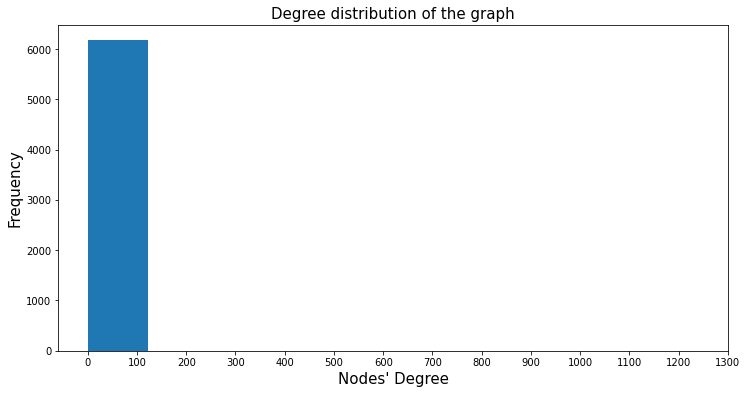

In [ ]:
# histogram with all the nodes
plt.figure(figsize=(12,6))
plt.hist(dict(covidiotsGraph.degree).values())
plt.xlabel("Nodes' Degree", size =15)
plt.ylabel("Frequency", size =15)
plt.xticks(range(0,1400,100))
plt.title("Degree distribution of the graph", size =15)
plt.show()

Observation: We can see that number of nodes with only 1 node degree is more, whereas one node particularly has very high number of edges (high node degree). the common trend observed is that nodes with node degree low are very common and there are only few nodes with high or very high node degree.

In [ ]:
len(list(dict_cidg.values()))

6179

In [ ]:
val = list(dict_cidg.values())
removed_extremes = [i for i in val if i != 1 and i != 1216]

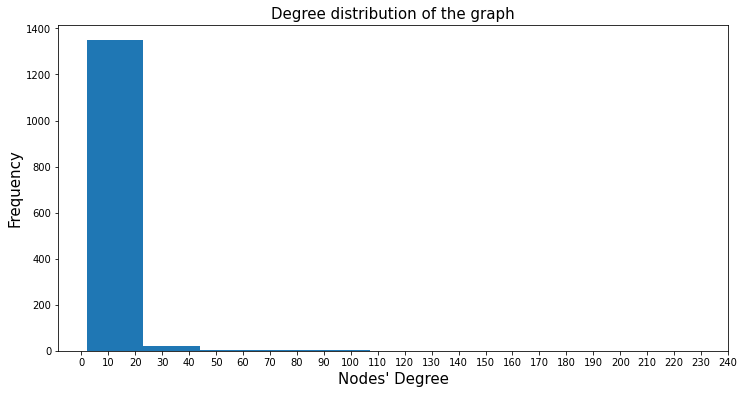

In [ ]:
# histogram with the extreme nodes removed to see the general trend
plt.figure(figsize=(12,6))
plt.hist(removed_extremes)
plt.xlabel("Nodes' Degree", size =15)
plt.ylabel("Frequency", size =15)
plt.xticks(range(0,250,10))
plt.title("Degree distribution of the graph", size =15)
plt.show()

Observation: We can see as the node degree increases the frequency tends to drop.

### c) Log-Log Scatter plot

In [ ]:
# Dataframe to add frequency and fraction of node degree frequency
df_scatter = pd.DataFrame(dict(Counter(list(dict_cidg.values()))).items(),columns=['Node_degree','Frequency']).sort_values(by=['Node_degree'])
df_scatter['node_fraction'] = df_scatter['Frequency'].apply(lambda x: x/len(covidiotsGraph.nodes()))

In [ ]:
df_scatter

,Node_degree,Frequency,node_fraction
6,1,4797,0.776339
2,2,712,0.115229
10,3,254,0.041107
5,4,140,0.022657
0,5,82,0.013271
1,6,31,0.005017
7,7,35,0.005664
17,8,26,0.004208
18,9,11,0.001780
14,10,11,0.001780


Text(0, 0.5, 'Fraction of Nodes')

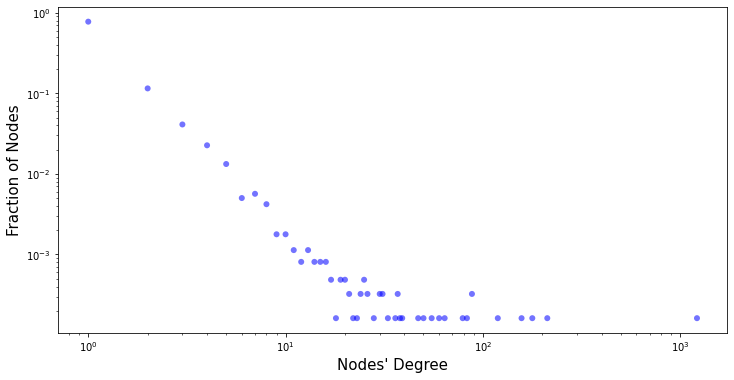

In [ ]:
# Scatter plot log-log node deg and fraction of nodes
fig = plt.figure(figsize=(12,6))
ax = plt.gca()
ax.scatter(df_scatter['Node_degree'] ,df_scatter['node_fraction'] , c='blue', alpha=0.55, edgecolors='none')
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel("Nodes' Degree", size =15)
ax.set_ylabel("Fraction of Nodes", size =15)

Observation: The Graph does show power law trend as the most of the nodes are with very less node degree and very few nodes have more edges. Therefore, in log scale we are able to see a linear trend in the node degree and fraction of the nodes.

Ref: https://www.statisticshowto.com/power-law/#:~:text=The%20power%20law%20(also%20called,4%20to%2016%20inches%20squared).

In [ ]:
dict_val = list(dict_cidg.values())
dict_keys = list(dict_cidg.keys())
print(f"The node with max number of edges is: #{dict_keys[dict_val.index(1216)]}")

The node with max number of edges is: #borisjohnson_mp


Observation: This agrees with the information available on the web. This term was introduced in UK, when several people gathering during covid-19 restrictions. 

Ref: https://www.financialexpress.com/lifestyle/coronavirus-outbreak-what-is-covidiots-trending-on-twitter/1907432/

### d) Highest weighted edge Tweets

In [ ]:
node_1 = []
node_2 = []
num_mentions = []

for (node1, node2) in covidiotsGraph.edges():
    edgeWidth = covidiotsGraph[node1][node2]['numberMentions']
    node_1.append(node1)
    node_2.append(node2)
    num_mentions.append(edgeWidth)

edge_weight_df = pd.DataFrame(
    {'node_1': node_1,
     'node_2': node_2,
     'num_mentions': num_mentions
    })


In [ ]:
# Node1, Node2 and then the weights for the same as mentioned below
edge_weight_df.sort_values(by=['num_mentions'],ascending=False).reset_index().drop('index',axis=1)

,node_1,node_2,num_mentions
0,adriandix,city604van,28
1,city604van,bcliberals,27
2,city604van,bcgreens,27
3,city604van,bcndp,27
4,city604van,bcndpcaucus,27
...,...,...,...
6279,kellsley,sachiknight,1
6280,kellsley,garysyms,1
6281,kellsley,mariecountryman,1
6282,kellsley,lynnietay,1


In [ ]:
# Checking 25 tweets (interation) between city604van and adriandix
i=0
for i in covidoitsTag[covidoitsTag["user"]=="city604van"]['tweet']:
  print(i)
  i=+1
  if i>25:
    break

@brendanpgraber 
The participation in such reckless selfish behaviour will hopefully produce a GVA lockdown by @adriandix @BCGreens @bcndp @BCNDPCaucus @bcliberals 

If peps can’t be responsible then fine them ($1000) &amp; lock them up B4 released !!! #COVIDIOTS #Vancouver #COVID19 https://t.co/HED9usdIYA
@BC1 @jarmstrongbc 

The participation in such reckless selfish behaviour will hopefully produce a GVA lockdown @adriandix @BCGreens @bcndp @BCNDPCaucus @bcliberals 

If peps can’t be responsible then fine them ($1000) &amp; lock them up B4 released !!! #COVIDIOTS #Vancouver #COVID19 https://t.co/rUNbuQrKPY
DISGUSTING!!!
The participation in such reckless selfish behaviour will hopefully produce a GVA lockdown by @adriandix @BCGreens @bcndp @BCNDPCaucus @bcliberals 

If peps can’t be responsible then fine them ($1000) &amp; lock them up B4 released !!! #COVIDIOTS #Vancouver #COVID19 https://t.co/mymOSS88ms
@PennyDaflos @CTVVancouver @Nic_Amaya The participation in such reckless selfi

Observation: We can see that most of the tweets are the same tweets by @city604van to @adriandix a minister in british columbia. Inherently since they have so may tweets in common, the edge weight between these two nodes are high.

### e) Mention graph 

In [ ]:
import random
def addRandomPositions(graph):
    posDict = dict((node,(random.gauss(0,10),random.gauss(0,10))) for node in graph.nodes())
    nx.set_node_attributes(graph, name="pos", values=posDict)

In [ ]:
addRandomPositions(covidiotsGraph)

In [ ]:
def plotNetworkSize(graph):
    scatters=[]

    # make all the edges
    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines',
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)


    # make all the nodes
    for node in graph.nodes():
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                hoverinfo='none',
                mode='markers', 
                marker=dict(
                    color="#888", 
                    size=nx.degree(graph,node)*0.25,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    # fig.update_layout(plot_bgcolor='rgb(10,10,10)')
    iplot(fig, show_link=False)

In [ ]:
# plotting covidiots mention graph
configure_plotly_browser_state()
plotNetworkSize(covidiotsGraph)

In [ ]:
# map purd color scale to 300 cells
purd = cl.scales['9']['seq']['YlOrRd']
purd300 = cl.interp(purd, 300)
HTML(cl.to_html(purd300))

In [ ]:
def plotNetworkSizeColor(graph):
    closenessCentr = nx.closeness_centrality(graph)
    maxCentr = max(closenessCentr.values())
    minCentr = min(closenessCentr.values())
    
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)



    for node in graph.nodes():
        nodeCentr = closenessCentr[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Closeness: %.3f" % (node, nodeCentr),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], 
                    size=nx.degree(graph,node)*0.25,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [ ]:
# plotting the same mention graph in color 
configure_plotly_browser_state()
plotNetworkSizeColor(covidiotsGraph)

Observation: This scatter plot represents the closeness centrality of the nodes. The dark color nodes represents high centrality. As discussed earlier, the borisjohnson_mp has high centrality value compared to other nodes. This closeness centrality shows how close both the nodes/users are with eachother in the network.

In [ ]:
# For spring layout
def applyLayout(graph, layoutFunc):
    posDict = layoutFunc(graph) 
    nx.set_node_attributes(graph, name="pos", values=posDict)

In [ ]:
# covidiots graph in spring layout
covidiotsGraphSpring = covidiotsGraph.copy()
applyLayout(covidiotsGraphSpring, nx.spring_layout)
configure_plotly_browser_state()
plotNetworkSizeColor(covidiotsGraphSpring)

Observation: From the plot we can see that there are some yellow nodes which are far away from the central node, which means there are very few mentions of the nodes with each other, however the nodes in the middle have higher mentions with other nodes.

## Q2 Content Analysis

In [ ]:
# processing tweets using tweet preprocessor (removes hashtags, stopwords, mentions)
covidoitsTag["preprocess_tweets"] = [p.clean(i) for i in covidoitsTag.tweet.values] #adding clean tweets column 
covidoitsTag.head()

,date,user,tweet,mentioned,preprocess_tweets
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...,[],: Vaccines against pneumonia do not provide pr...
5091,2020-11-01 04:30:07,drcsyntax,Watching the original Dawn of The Dead tonight...,[],Watching the original Dawn of The Dead tonight...
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...,[teamtrump],Like chills down my spine.
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...,"[busydrt, borisjohnson]",: The world knows that are a scam with no basi...
6734,2020-11-01 04:31:25,gwarkowianka,#Covid19 #covidiots read on... https://t.co/SM...,[],read on...


### a) Most Frequent Non-Stop words

In [ ]:
def get_stop_words():
    stop = set(stopwords.words('english'))
    # stop.add("twitter") 
    return stop

def getTopKWords(df, kwords):

    stop = get_stop_words()
    counter = Counter()
    tweets = df['preprocess_tweets'].values
    for tweet in tweets:
            counter.update([word.lower() 
                            for word 
                            in re.findall(r'\w+', tweet)
                            if word.lower() not in stop and len(word) > 2 ])
    topk = counter.most_common(kwords)
    return topk

In [ ]:
# Top 50 nonstop words in the tweets 
getTopKWords(covidoitsTag, 50)

[('see', 1494),
 ('still', 1373),
 ('well', 1357),
 ('good', 1312),
 ('shelves', 1232),
 ('stocked', 1222),
 ('people', 805),
 ('one', 602),
 ('amp', 447),
 ('covid', 397),
 ('lockdown', 371),
 ('get', 346),
 ('like', 321),
 ('please', 321),
 ('think', 313),
 ('life', 311),
 ('take', 297),
 ('health', 292),
 ('need', 254),
 ('risk', 251),
 ('masks', 248),
 ('going', 246),
 ('would', 233),
 ('supermarket', 231),
 ('works', 223),
 ('condition', 218),
 ('mask', 208),
 ('selfish', 207),
 ('time', 204),
 ('trump', 200),
 ('dont', 189),
 ('fucking', 188),
 ('wear', 185),
 ('many', 182),
 ('greedy', 180),
 ('know', 169),
 ('right', 165),
 ('others', 164),
 ('virus', 150),
 ('really', 141),
 ('pandemic', 137),
 ('new', 136),
 ('another', 135),
 ('https', 134),
 ('stop', 131),
 ('make', 128),
 ('rallies', 127),
 ('stupid', 123),
 ('world', 120),
 ('last', 118)]

Observation: After preprocessing, by analysing the tweets we can understand that the main theme revolves around people who are negligent towards COVID-19, words such as pandemic, mask, wear, greedy and rallies convey the intended message.

Also, it can be seen that many people express the need for wearing masks in public like super market, rallies etc.,

### b) Visualization of the mention graph to mention three most common words for each user

In [ ]:
# defining color for empty nodes
empty_node = cl.scales['9']['seq']['Greys'][6]
empty_node

'rgb(82,82,82)'

In [ ]:
# selecting top 3 words of the users
def userWiseTopWords(df, user):
  new_df = df[df["user"]==user]
  words = getTopKWords(new_df, 3)
  top3_words = [word[0] for word in words]
  return top3_words

In [ ]:
def plotNetworkSizeColor_nodes_words(graph):
    closenessCentr = nx.closeness_centrality(covidiotsGraph)
    maxCentr = max(closenessCentr.values())
    minCentr = min(closenessCentr.values()) 
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)

    for node in graph.nodes():
        nodeCentr = closenessCentr[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))

        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Closeness: %.3f <br> Top3_words: %s" % (node, nodeCentr, str(userWiseTopWords(covidoitsTag, user=node))),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color= empty_node if len(userWiseTopWords(covidoitsTag, user=node)) == 0 else purd300[nodeColor], 
                    size=nx.degree(graph,node)*0.25,
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)


In [ ]:
# plotting the spring graph with top three words
configure_plotly_browser_state()
plotNetworkSizeColor_nodes_words(covidiotsGraphSpring)

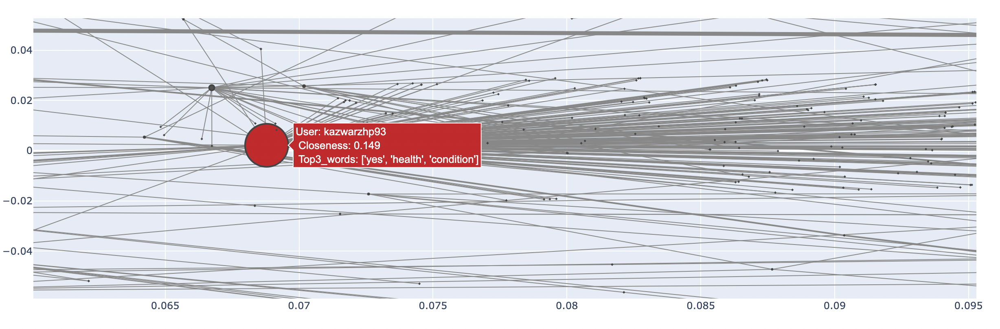

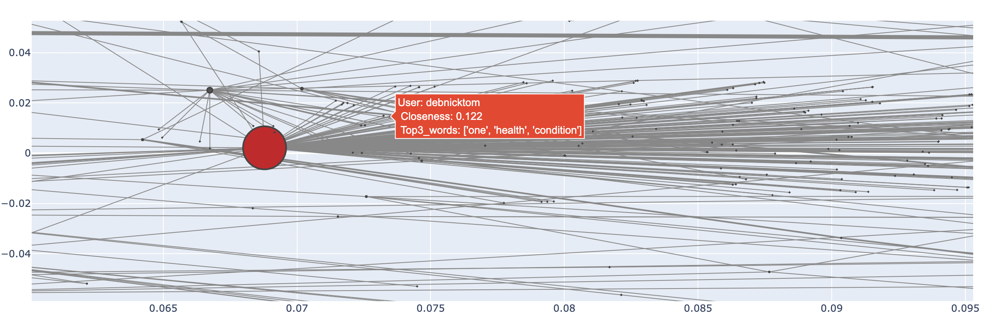

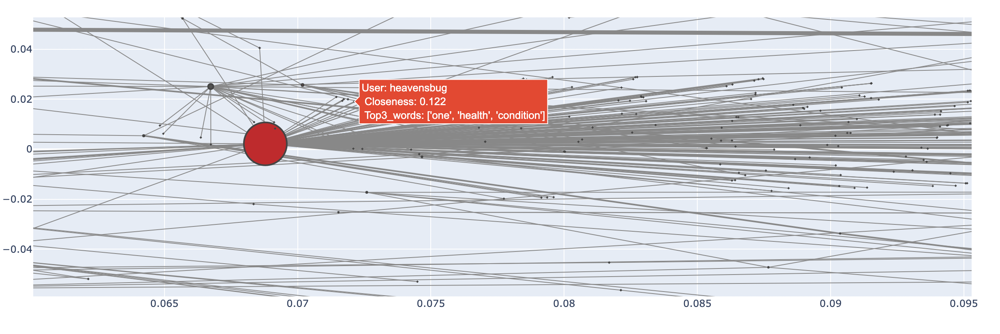

Observation: In the mention spring graph we can see that the grey color node are the nodes without top three words, as per the limit set by us, the grey nodes doesnt seem to have useful information for us.

Also, the nodes which are connected and that has top three words are almost inline with each other. Most of the theme of nodes are about the mass gathering and rallies for political agenda during COVID destruction.

## Q3 Centrality Analysis

In [ ]:
def plotNetworkSizeColor_centrality(graph , centrality_measure):
    if centrality_measure == "betweenness":
      # if betweenness centrality 
      centrality = nx.betweenness_centrality(covidiotsGraph)  
    else:
      # if pagerank 
      centrality = nx.pagerank(covidiotsGraph)  
    maxCentr = max(centrality.values())
    minCentr = min(centrality.values())
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)

    for node in graph.nodes():
        nodeCentr = centrality[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Closeness: %.3f <br> Top3_words: %s" % (node, nodeCentr, str(userWiseTopWords(covidoitsTag, user=node))),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], 
                    size=nx.degree(graph,node)*0.25,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [ ]:
# checking pagreranks values
pagerank_covidiots  = nx.pagerank(covidiotsGraphSpring)
pagerank_covidiots

{'odysseyrabbit': 0.0002582400111536036,
 'teamtrump': 0.000299699805187338,
 'fahadaz63501106': 0.00010387522429005382,
 'busydrt': 0.002464735685783091,
 'borisjohnson': 0.005839866692631506,
 'wittatwitta': 0.00030538890011911295,
 'david13353252': 8.910832495177966e-05,
 'darrylbain1967': 8.910832495177966e-05,
 'petercredlin_pw': 8.910832495177966e-05,
 'danielandrewsmp': 0.00037866715661047726,
 'greenpeaches2': 8.158018989012122e-05,
 'axios': 0.00047142211994383827,
 'roxdog2012': 0.000115456162455388,
 'kayleighmcenany': 0.0003840893920305348,
 'realdonaldtrump': 0.008207257030019607,
 'aleeah26765972': 0.00010387522429005382,
 'conlibe': 8.340494503705937e-05,
 'nbcnews': 0.00027773761227532177,
 'tspin18': 0.00010387522429005382,
 'kittykatbalou': 0.00012550789343394712,
 'cnnpolitics': 0.00013341822916983795,
 'kate_eviva': 0.00020200278078681854,
 'hazrobert': 0.00014175633739425863,
 'xoahubeachx': 9.768946702845902e-05,
 'caroljhedges': 0.0006108816123350153,
 'beauty_da

In [ ]:
#plotting using pragerank centrality
configure_plotly_browser_state()
plotNetworkSizeColor_centrality(covidiotsGraphSpring , centrality_measure = "page_rank")

In [ ]:
configure_plotly_browser_state()
plotNetworkSizeColor_centrality(covidiotsGraph , centrality_measure = "page_rank")

In [ ]:
# betweenness centrality measure
betweeness_covidiots  = nx.betweenness_centrality(covidiotsGraphSpring, normalized= True)
betweeness_covidiots

{'odysseyrabbit': 0.00047566302815768514,
 'teamtrump': 0.0002743140369325993,
 'fahadaz63501106': 1.5234936887260183e-06,
 'busydrt': 0.0038461689009506184,
 'borisjohnson': 0.08674443276337486,
 'wittatwitta': 9.433589963666528e-06,
 'david13353252': 0.0,
 'darrylbain1967': 0.0,
 'petercredlin_pw': 0.0,
 'danielandrewsmp': 3.8537961962682166e-05,
 'greenpeaches2': 0.0,
 'axios': 0.0013751415453743063,
 'roxdog2012': 0.0002576182529025672,
 'kayleighmcenany': 0.0011768148149603943,
 'realdonaldtrump': 0.11895893376873388,
 'aleeah26765972': 1.5234936887260183e-06,
 'conlibe': 0.0,
 'nbcnews': 0.001520118204978598,
 'tspin18': 1.5234936887260183e-06,
 'kittykatbalou': 0.00022941491030298435,
 'cnnpolitics': 4.1464911460364325e-05,
 'kate_eviva': 0.0,
 'hazrobert': 0.0,
 'xoahubeachx': 0.0,
 'caroljhedges': 1.100585495761095e-06,
 'beauty_damned': 0.0,
 'manairport': 0.0,
 'jenxpaige': 0.0,
 'mysterysolvent': 0.0026051120728830778,
 'blacksherrybl': 0.0,
 'king_of_shade': 5.240883313148

In [ ]:
# plotting the graph with betweenness centrality measure
configure_plotly_browser_state()
plotNetworkSizeColor_centrality(covidiotsGraphSpring , centrality_measure = "betweenness")

In [ ]:
# using mention graph as earlier
configure_plotly_browser_state()
plotNetworkSizeColor_centrality(covidiotsGraph , centrality_measure = "betweenness")

### b) Top 5 central nodes for each centrality measures

In [ ]:
print(f"Top 5 central nodes by pagerank: {sorted(nx.pagerank(covidiotsGraphSpring), key=nx.pagerank(covidiotsGraphSpring).get, reverse=True)[:5]}")

Top 5 central nodes by pagerank: ['borisjohnson_mp', 'kazwarzhp93', 'thelastpersont2', 'realdonaldtrump', 'vantahku']


In [ ]:
print(f"Top 5 central nodes by betweenness centrality: {sorted(nx.betweenness_centrality(covidiotsGraphSpring), key=nx.betweenness_centrality(covidiotsGraphSpring).get, reverse=True)[:5]}")

Top 5 central nodes by betweenness centrality: ['borisjohnson_mp', 'realdonaldtrump', 'borisjohnson', 'kazwarzhp93', 'piersmorgan']


Observation: the Results between centrality are similar to each other, In both the measures, we can see that borisjohnson_mp is the central node. 
PageRank gives high centrality score to users based on the Indegree (i.e., based on users mentioning other users) whereas betweenness centrality gives more score to the nodes acting as a bridge in information transfer between other nodes.

ref: https://cambridge-intelligence.com/keylines-faqs-social-network-analysis/

Betweenness centrality is better suited for Twitter data analysis as we can analyse the communication dynamics, if the score of a node is higher it implies that the node connects with many other nodes (acts as a bridge) for communication.

For my network, betweenness centrality is the apt measure because, we can understand that which nodes pass more information (ie., we can understand which node play important role in gathering all the information)

## 4) Sentiment Analysis

In [ ]:
# Adding emotion to the tweets
covidoitsTag_emotion = covidoitsTag.copy()
columns = ["anger","anticipation","disgust","fear","joy","negative","positive","sadness","surprise","trust"]
covidoitsTag_emotion[columns] = 0

for index, data in covidoitsTag_emotion.iterrows():
  tweet = data['tweet']
  text_object = NRCLex(tweet)
  absolute_numbers = text_object.raw_emotion_scores
  for i in columns:
    for j in list(absolute_numbers):
      if i==j:
        covidoitsTag_emotion[i][index]= absolute_numbers[i]

covidoitsTag_emotion.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,user,tweet,mentioned,preprocess_tweets,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...,[],: Vaccines against pneumonia do not provide pr...,0,0,0,1,0,1,1,0,0,2
5091,2020-11-01 04:30:07,drcsyntax,Watching the original Dawn of The Dead tonight...,[],Watching the original Dawn of The Dead tonight...,1,0,0,1,0,1,2,0,1,2
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...,[teamtrump],Like chills down my spine.,1,0,0,0,0,1,1,0,0,0
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...,"[busydrt, borisjohnson]",: The world knows that are a scam with no basi...,0,0,0,0,0,0,0,0,0,0
6734,2020-11-01 04:31:25,gwarkowianka,#Covid19 #covidiots read on... https://t.co/SM...,[],read on...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# the number of words in each dimension of emotions 
sentiment_counts = covidoitsTag_emotion[columns].sum(axis=0)
sentiment_counts

anger           1872
anticipation    1958
disgust         1949
fear            2639
joy             1242
negative        5200
positive        3544
sadness         2007
surprise         886
trust           2468
dtype: int64

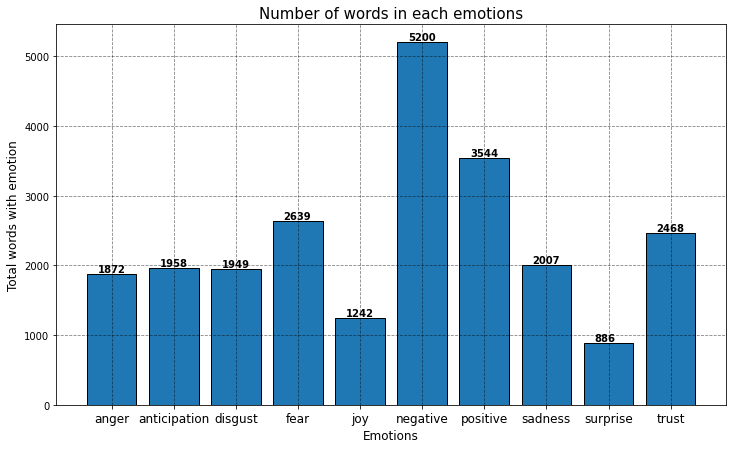

In [ ]:
# bar graph for number of words in each emotions

plt.figure(figsize=(12,7))
plt.bar(columns,sentiment_counts, edgecolor='k')
for i, val in enumerate(sentiment_counts):
    plt.text(i-0.23, val+30, f'{np.round((val), 2)}', weight='bold', fontsize=10, color='k')
plt.xlabel("Emotions", size = 12)
plt.xticks(size = 12)
plt.ylabel("Total words with emotion", size = 12)
plt.title("Number of words in each emotions", size = 15)
plt.grid(alpha=0.5, color='k', linestyle='--')
plt.show()

In [ ]:
# checking the negative tweets
covidoitsTag_emotion[covidoitsTag_emotion["negative"]==5]["tweet"].values[2]

"@noseychatchat @BorisJohnson I'm angry. I've lost my business . Selling house. Savings run out in 6 weeks. Lockdown means another month with no income and a mortgage to pay as house sale delayed. That's what will kill me. Been socially distancing since March, unlike the #COVIDIOTS"

In [ ]:
covidoitsTag_emotion[covidoitsTag_emotion["negative"]==5]["tweet"].values[5]

'People don’t bother to wear masks &amp; are quick to blame government regarding handling of virus! #2ndLockdown #COVIDIOTS'

Observation: The negative words in the tweets are more. In line with the Hashtag choosen, covidiots: refers to people who dont follow the precautions necessary for tackling COVID, there will be lot of negative words. When analysing the few tweets from the data, it can be seen that most of the negative words are related to unawareness of people and politicians who gather rallies and another particular view is that people who lost their jobs / people who are not able to get better income becuase of COVID also used lot of negative words.

## b) Fraction of a user’s total identified words which are in each emotional affect

In [ ]:
# checking the length of unique users
len(covidoitsTag["user"].unique())

5734

In [ ]:
# userwise addition of each emotion 
covidoitsTag_emotion_userwise = pd.DataFrame(covidoitsTag_emotion.groupby('user')[columns].sum())
covidoitsTag_emotion_userwise.shape 

(5734, 10)

In [ ]:
# adding total counts of words column in the dataframe
covidoitsTag_emotion_userwise["total_words"] = covidoitsTag_emotion_userwise.sum(axis=1)
covidoitsTag_emotion_userwise.head()

,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,total_words
user,,,,,,,,,,,
098clr123,0,0,0,0,0,0,0,0,0,0,0
0ttam,2,2,2,2,0,3,1,2,1,1,16
101thedr,0,0,0,0,0,0,0,0,0,0,0
12flute1,0,0,0,0,0,0,0,0,0,0,0
1300claude,0,0,0,0,0,1,1,0,0,0,2


In [ ]:
covidoitsTag_emotion_userwise_fraction = covidoitsTag_emotion_userwise[columns].div(covidoitsTag_emotion_userwise["total_words"], axis = 0).round(2) # finding fraction of words per user by dividing total count of words
covidoitsTag_emotion_userwise_fraction["total_words"] = covidoitsTag_emotion_userwise["total_words"]
covidoitsTag_emotion_userwise_fraction = covidoitsTag_emotion_userwise_fraction.replace(np.nan, 0 ) # replacing NaN values as it is coming from zero division
covidoitsTag_emotion_userwise_fraction.head()

,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,total_words
user,,,,,,,,,,,
098clr123,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0
0ttam,0.12,0.12,0.12,0.12,0.0,0.19,0.06,0.12,0.06,0.06,16
101thedr,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0
12flute1,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0
1300claude,0.00,0.00,0.00,0.00,0.0,0.50,0.50,0.00,0.00,0.00,2


In [ ]:
# users with the highest fraction of words in each emotion
covidoitsTag_emotion_userwise_fraction.idxmax()

anger           boyecollins2017
anticipation           666tweet
disgust                329hoady
fear                69nicebot69
joy             chrischapmanart
negative                  3sea1
positive             1bradyboy1
sadness             caveman4107
surprise           arniemgeller
trust                aconda_ann
total_words          city604van
dtype: object

### c) Correlation between dimension of emotion and centrality measure

In [ ]:
 # total number of users 
 covidoitsTag_emotion["user"].shape

(6942,)

In [ ]:
# total number of nodes in betweenness centrality 
len(betweeness_covidiots)

6179

In [ ]:
# total number of nodes in pagerank centrality 
len(pagerank_covidiots)

6179

In [ ]:
# mapping users with betweenness centrality and pagerank centrality
covidoitsTag_emotion['betweenness_centrality'] = covidoitsTag_emotion['user'].map(betweeness_covidiots)
covidoitsTag_emotion['pagerank'] = covidoitsTag_emotion['user'].map(pagerank_covidiots)
covidoitsTag_emotion.head()

,date,user,tweet,mentioned,preprocess_tweets,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,betweenness_centrality,pagerank
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...,[],: Vaccines against pneumonia do not provide pr...,0,0,0,1,0,1,1,0,0,2,0.016513,0.001673
5091,2020-11-01 04:30:07,drcsyntax,Watching the original Dawn of The Dead tonight...,[],Watching the original Dawn of The Dead tonight...,1,0,0,1,0,1,2,0,1,2,NaN,NaN
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...,[teamtrump],Like chills down my spine.,1,0,0,0,0,1,1,0,0,0,0.000476,0.000258
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...,"[busydrt, borisjohnson]",: The world knows that are a scam with no basi...,0,0,0,0,0,0,0,0,0,0,0.000002,0.000104
6734,2020-11-01 04:31:25,gwarkowianka,#Covid19 #covidiots read on... https://t.co/SM...,[],read on...,0,0,0,0,0,0,0,0,0,0,NaN,NaN


In [ ]:
# dropping rows where NA is there for betweeness centrality and page rank
# becuase some nodes dont refer eachother 

covidoitsTag_emotion = covidoitsTag_emotion.dropna()
covidoitsTag_emotion.head()

,date,user,tweet,mentioned,preprocess_tweets,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,betweenness_centrality,pagerank
1705,2020-11-01 04:27:20,swerianbot,#fact : Vaccines against pneumonia do not prov...,[],: Vaccines against pneumonia do not provide pr...,0,0,0,1,0,1,1,0,0,2,0.016513,0.001673
6676,2020-11-01 04:31:22,odysseyrabbit,@TeamTrump Like chills down my spine. #COVID19...,[teamtrump],Like chills down my spine.,1,0,0,0,0,1,1,0,0,0,0.000476,0.000258
6679,2020-11-01 04:31:22,fahadaz63501106,RT @BusyDrT: The world knows that #lockdowns a...,"[busydrt, borisjohnson]",: The world knows that are a scam with no basi...,0,0,0,0,0,0,0,0,0,0,0.000002,0.000104
8800,2020-11-01 04:33:06,wittatwitta,@David13353252 @DarrylBain1967 @PeterCredlin_P...,"[david13353252, darrylbain1967, petercredlin_p...",This one's just for you ...,0,0,0,0,0,0,0,0,0,0,0.000009,0.000305
12641,2020-11-01 04:36:20,greenpeaches2,@axios #Covidiots who only care about themselv...,[axios],who only care about themselves; like trump. De...,0,0,0,0,0,0,0,0,1,0,0.000000,0.000082


In [ ]:
# correlation of all the emotions
corr_covidiots = covidoitsTag_emotion[["anger","anticipation","disgust","fear","joy","negative","positive","sadness","surprise","trust","betweenness_centrality","pagerank"]].corr() 
corr_covidiots

,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,betweenness_centrality,pagerank
anger,1.000000,0.215460,0.632447,0.545312,0.188212,0.677183,0.288739,0.590897,0.326303,0.220127,0.069968,0.026742
anticipation,0.215460,1.000000,0.098062,0.359085,0.521666,0.262686,0.454411,0.254252,0.457200,0.424847,0.037673,-0.001130
disgust,0.632447,0.098062,1.000000,0.447846,0.218010,0.691483,0.218714,0.467247,0.195036,0.225992,0.003583,0.007320
fear,0.545312,0.359085,0.447846,1.000000,0.215759,0.717544,0.284157,0.656365,0.266180,0.248072,0.044315,0.009061
joy,0.188212,0.521666,0.218010,0.215759,1.000000,0.242293,0.617690,0.188449,0.516438,0.599863,0.077840,0.010764
negative,0.677183,0.262686,0.691483,0.717544,0.242293,1.000000,0.306864,0.692282,0.284620,0.303949,0.032536,0.009275
positive,0.288739,0.454411,0.218714,0.284157,0.617690,0.306864,1.000000,0.267715,0.375115,0.714410,0.020063,0.009012
sadness,0.590897,0.254252,0.467247,0.656365,0.188449,0.692282,0.267715,1.000000,0.342882,0.251690,-0.002759,0.002994
surprise,0.326303,0.457200,0.195036,0.266180,0.516438,0.284620,0.375115,0.342882,1.000000,0.331271,0.094139,0.009337
trust,0.220127,0.424847,0.225992,0.248072,0.599863,0.303949,0.714410,0.251690,0.331271,1.000000,0.001406,0.014021


In [ ]:
# correlation of all emotions with respection to betweenness centrality
corr_bc = abs(corr_covidiots["betweenness_centrality"])
relative_emotions_bc =pd.DataFrame(corr_bc)

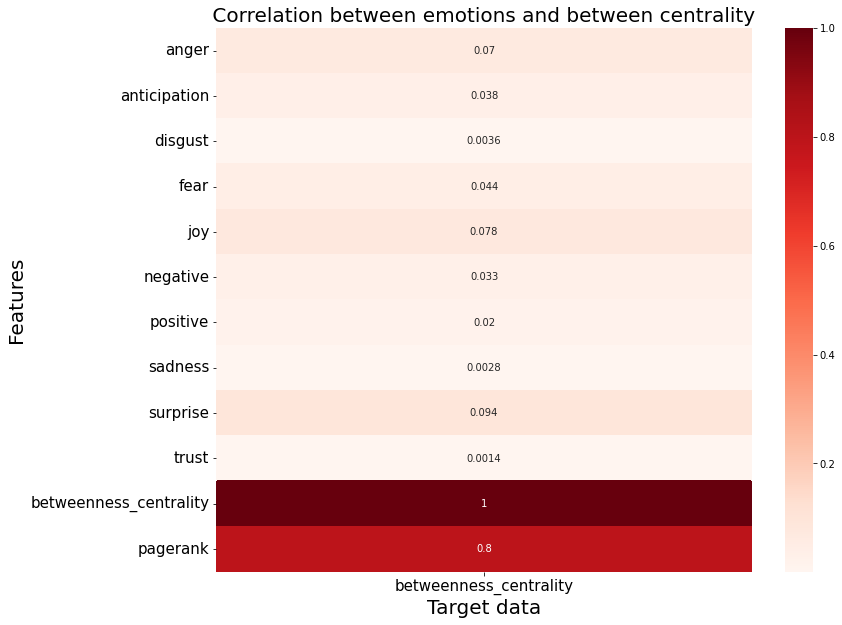

In [ ]:
plt.figure(figsize=(12,10))
sns.heatmap(relative_emotions_bc, annot=True, cmap=plt.cm.Reds)
plt.title(' Correlation between emotions and between centrality ' , size = 20)
plt.xlabel('Target data',  size = 20)
plt.ylabel('Features',  size = 20)
plt.xticks(size=15)
plt.yticks(size=15)
plt.show()

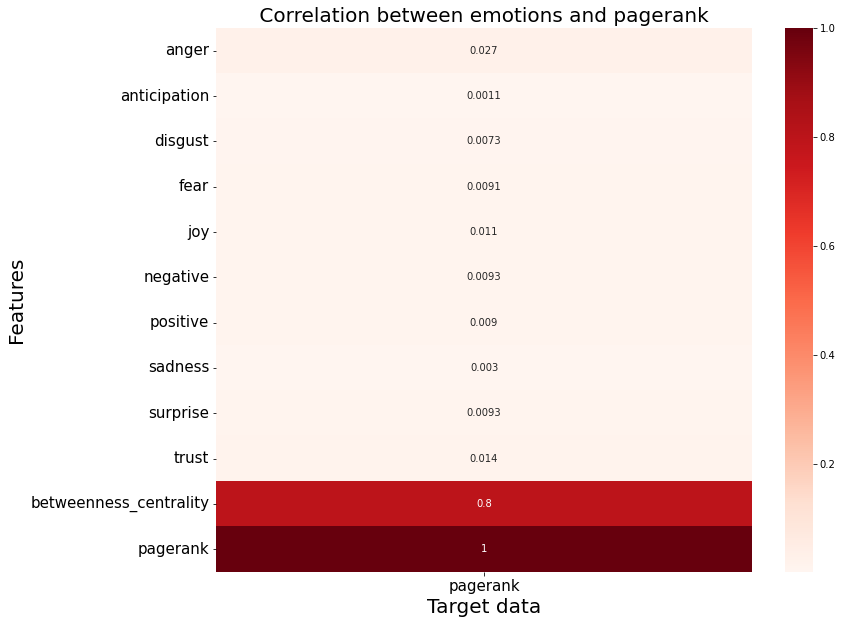

In [ ]:
# Correlation with respect ot pagerank centrality (modified version of eigen value centrality)
corr_pr = abs(corr_covidiots["pagerank"])
relevant_emotions_pr =pd.DataFrame(corr_pr)
plt.figure(figsize=(12,10))
sns.heatmap(relevant_emotions_pr, annot=True, cmap=plt.cm.Reds)
plt.title(' Correlation between emotions and pagerank ' , size = 20)
plt.xlabel('Target data',  size = 20)
plt.ylabel('Features',  size = 20)
plt.xticks(size=15)
plt.yticks(size=15)
plt.show()


In [ ]:
# sorting values by betweenness centrality column
covidoitsTag_emotion.sort_values(by = "betweenness_centrality", ascending= False).head(20)

,date,user,tweet,mentioned,preprocess_tweets,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,betweenness_centrality,pagerank
834513,2020-11-01 13:54:04,borisjohnson_mp,Good to see some shelves are still well stocke...,[],Good to see some shelves are still well stocked.,0,0,0,0,0,0,0,0,0,0,0.254925,0.089241
693801,2020-11-01 12:44:54,borisjohnson_mp,Fascinating Venn diagram showing the overlap b...,[],Fascinating Venn diagram showing the overlap b...,0,0,0,0,0,0,0,0,0,0,0.254925,0.089241
413758,2020-11-01 10:04:49,kazwarzhp93,My tweet has exploded yes I do have a health c...,[],My tweet has exploded yes I do have a health c...,1,1,0,1,0,2,0,1,0,2,0.059995,0.014816
242193,2020-11-01 08:14:37,kazwarzhp93,"#COVIDIOTS this one is for you, I have a healt...",[],"this one is for you, I have a health condition...",0,2,0,1,0,2,0,1,0,0,0.059995,0.014816
1197032,2020-11-01 16:41:41,1liesalot,RT @BorisJohnson_MP: Good to see some shelves ...,[borisjohnson_mp],: Good to see some shelves are still well stoc...,0,0,0,0,0,0,0,0,0,0,0.048428,0.000439
1298062,2020-11-01 17:27:46,1liesalot,@MyTweetUK @BristolCouncil @BBCNews @SkyNews @...,"[mytweetuk, bristolcouncil, bbcnews, skynews, ...",Stop punching down. Punching down is what the ...,0,0,0,0,0,0,0,0,0,0,0.048428,0.000439
637085,2020-11-01 12:14:46,lorajam71621350,I will blast your YouTube channel and videos t...,[],I will blast your YouTube channel and videos t...,1,1,0,1,1,1,1,0,1,0,0.047509,0.001416
627923,2020-11-01 12:09:47,lorajam71621350,@WSJbusiness \nI will blast your YouTube chann...,[wsjbusiness],I will blast your YouTube channel and videos t...,1,1,0,1,1,1,1,0,1,0,0.047509,0.001416
641261,2020-11-01 12:17:03,lorajam71621350,@SkyNewsBreak \nI will blast your YouTube chan...,[skynewsbreak],I will blast your YouTube channel and videos t...,1,1,0,1,1,1,1,0,1,0,0.047509,0.001416
640358,2020-11-01 12:16:34,lorajam71621350,@SkyNews \nI will blast your YouTube channel a...,[skynews],I will blast your YouTube channel and videos t...,1,1,0,1,1,1,1,0,1,0,0.047509,0.001416


In [ ]:
# sorting values by pagerank centrality column
covidoitsTag_emotion.sort_values(by = "pagerank", ascending= False).head(20)

,date,user,tweet,mentioned,preprocess_tweets,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust,betweenness_centrality,pagerank
693801,2020-11-01 12:44:54,borisjohnson_mp,Fascinating Venn diagram showing the overlap b...,[],Fascinating Venn diagram showing the overlap b...,0,0,0,0,0,0,0,0,0,0,0.253382,0.088723
834513,2020-11-01 13:54:04,borisjohnson_mp,Good to see some shelves are still well stocke...,[],Good to see some shelves are still well stocked.,0,0,0,0,0,0,0,0,0,0,0.253382,0.088723
413758,2020-11-01 10:04:49,kazwarzhp93,My tweet has exploded yes I do have a health c...,[],My tweet has exploded yes I do have a health c...,1,1,0,1,0,2,0,1,0,2,0.059563,0.014717
242193,2020-11-01 08:14:37,kazwarzhp93,"#COVIDIOTS this one is for you, I have a healt...",[],"this one is for you, I have a health condition...",0,2,0,1,0,2,0,1,0,0,0.059563,0.014717
1036757,2020-11-01 15:27:44,thelastpersont2,@GodfreyOSWALD We'll have to get @susie_dent o...,"[godfreyoswald, susie_dent]",We'll have to get on the case!,0,0,0,1,0,1,0,1,0,0,0.041414,0.011997
467320,2020-11-01 10:36:44,thelastpersont2,No Nut November is difficult to achieve with t...,[],No Nut November is difficult to achieve with t...,0,0,0,1,1,0,1,0,0,1,0.041414,0.011997
597188,2020-11-01 11:52:50,thelastpersont2,Don't be one of these #covidiots... 🤦‍♀️\n\n#p...,[],Don't be one of these ...,0,0,0,0,0,0,0,0,0,0,0.041414,0.011997
500375,2020-11-01 10:56:53,thelastpersont2,Only #COVIDIOTS say #WeWillNotComply with the ...,[],Only say with the lockdown...,0,0,0,0,0,0,0,0,0,0,0.041414,0.011997
142582,2020-11-01 06:37:53,vantahku,@KaiEgw @adrianahoyos @GOP @realDonaldTrump Th...,"[kaiegw, adrianahoyos, gop, realdonaldtrump]",There is still time!,0,1,0,0,0,0,0,0,0,0,0.019190,0.006087
173417,2020-11-01 07:08:54,vantahku,@TheChang707 @Ink8Judy @rhetoricalTodd @JoeBid...,"[thechang707, ink8judy, rhetoricaltodd, joebiden]",Trump is the worst human ever born!,0,0,0,0,0,0,0,0,0,0,0.019190,0.006087


Observation: with the correlation plot between the betweenness centrality and emotions we can see that surprise seems to be the highly correlated feature, that is understandable as most of the tweets are about the unexpected situations where people unknowingly do things which are not good precautionary measure against COVID. 

Also when we see the same with pagerank centrality and emotions trust seems to be highly correlated which is does not actually convey the message. Therefore, it proves our point in the part 3 that betweenness centrality is better apt for analysing communications.